In [2]:
# -*- coding: utf-8 -*-
import matplotlib.pyplot as plt
import numpy as np
import gzip
from inception_v3_archisen import InceptionV3  #this inputes are uint8 to check for shalpley problems
import keras
from skimage.segmentation import slic
import pandas as pd
import cv2

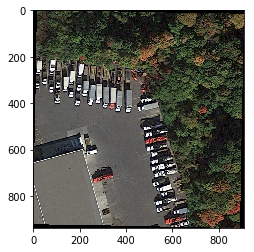

In [4]:
plt.imshow(plt.imread('./images/P0342.png'))
plt.show()

In [42]:
plt.imshow(plt.imread('./images/'+i[:-3]+'png'))

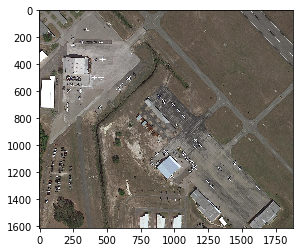

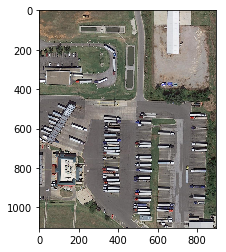

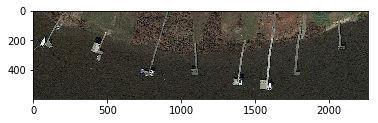

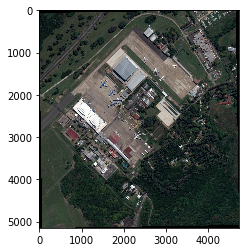

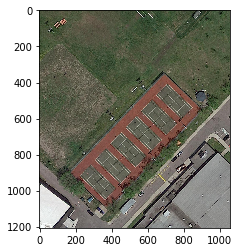

...

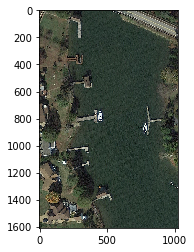

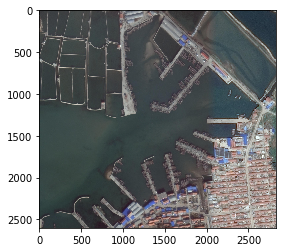

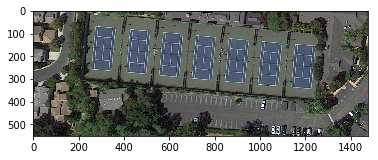

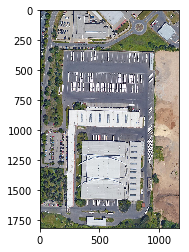

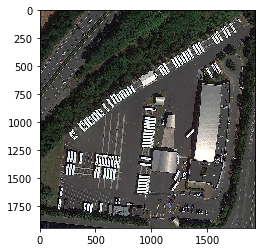

{'ship': 77, 'plane': 49, 'vehicle': 165}


In [43]:
import os
dictt = {}
classes = ['ship','plane','large-vehicle','small-vehicle']
new_dictt = {'ship':'ship','plane':'plane','large-vehicle':'vehicle','small-vehicle':'vehicle'}
import collections
for i in os.listdir('labelTxt/'):
    try:
        data =pd.read_csv('./labelTxt/'+i,skiprows=2,header=None,delimiter=' ')
        data =   data[data[8].isin(classes)].reset_index(drop=True)
        data[8] = data[8].map(new_dictt)
        if  max(collections.Counter(data[8])) not in dictt:
            dictt[max(collections.Counter(data[8]))] = 1
        else :
            dictt[max(collections.Counter(data[8]))] += 1
        plt.imshow(plt.imread('./images/'+i[:-3]+'png'))
        plt.show()
    except : None#print i
print dictt

(937, 907, 3)


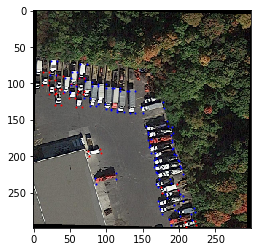

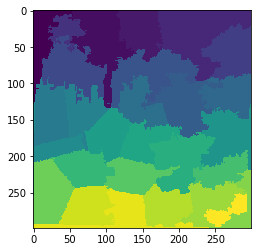

      0    1    2    3    4    5    6    7              8  9
0   635  930  631  913  674  906  677  922  small-vehicle  0
1   174  377  150  377  155  318  180  321  small-vehicle  0
2   115  338   91  337   97  280  120  282  small-vehicle  0
3    89  357   64  356   64  297   91  297  small-vehicle  0
4    60  321   35  320   38  264   65  263  small-vehicle  0
5   513  633  508  614  580  595  586  616  large-vehicle  0
6   536  874  529  856  584  838  590  858  large-vehicle  0
7   609  884  605  865  666  849  672  869  large-vehicle  0
8   557  807  549  790  602  771  609  791  large-vehicle  0
9   520  762  514  746  568  726  574  742  large-vehicle  0
10  426  440  399  441  396  345  425  344  large-vehicle  0
11  325  423  301  423  303  333  329  333  large-vehicle  0
12  296  401  269  402  271  317  299  317  large-vehicle  0
13  262  412  235  410  245  322  271  324  large-vehicle  0
14  216  291  190  289  195  229  221  230  large-vehicle  0
15  178  322  156  320  

In [17]:
data =pd.read_csv('./labelTxt/P0342.txt',skiprows=2,header=None,delimiter=' ')
img=  plt.imread('./images/P0342.png')
print img.shape
img = cv2.resize(img,(299,299))
plt.imshow(img)
for i in range(len(data)):
    x = np.round(data.iloc[i][[0,2,4,6]].astype(np.float32).values*299/907).astype('uint16')
    y = np.round(data.iloc[i][[1,3,5,7]].astype(np.float32).values*299/937).astype('uint16')
    
    if data.iloc[i][8] == 'small-vehicle':
        plt.scatter(x,y,s=1,c='red')
    else:
        plt.scatter(x,y,s=1,c='blue')
plt.show()
plt.imshow(slic(img, n_segments=55, compactness=10, sigma=0.5))
plt.show()
print data
